# Dynamic estimation of multinomial logit choice models

Max Kapur | [maxkapur.com](https://www.maxkapur.com)

In this notebook, I demonstrate how to estimate the parameters of a multinomial logit (MNL) choice model by max likelihood. I extend this method to the nested MNL model.

Next, I offer a parameter estimation technique for the dynamic or "data stream" scenario in which observations of consumer choices come in one at a time and cannot be stored permanently. The technique is based on a gradient process and stochastically converges in both nested and nonnested cases. Moreover, it is simpler to compute than the maximum likelihood estimator, and offers an alternative to optimization when there are many products in the model.

In [1]:
using Random
using StatsBase
using DataFrames
ENV["COLUMNS"] = 10000
using Optim
using Plots
using Plots.Measures: pt
using IterTools: product
using Distributions: Gumbel, Chisq, ccdf

In [2]:
"""
    rollingaverage(A, rad=10)

Compute a rolling average of radius `rad` over the rows of the matrix `A`,
padding the left with shorter averages to preserve `A`'s dimension. 
"""
function rollingaverage(A, rad=10)
    (n, m) = size(A)
    res = zeros(n, m)
    
    for j in 1:n
        res[j, :] = [i < rad ? mean(A[j, begin:i]) : mean(A[j, i-rad+1:i]) for i in 1:m]
    end
    
    return res
end

rollingaverage

## Multinomial logit models

MNL choice is a random utility model that quantifies consumers' choice of one product among a given assortment. Suppose there are $n$ products (indexed $i$), and $m$ (indexed by $j$) consumers are shown some combination or assortment $\mathcal{A}_j$ of the products. Each product is associated with a base utility parameter $\delta_i \in \mathbb{R}^n$. Each consumer takes the vector $\delta$ and adds to it $\epsilon$, a vector of iid noise with an extreme value distribution. This results in customer-specific ranking of the products, and each customer chooses the product she likes most (i.e., the one for which $\delta_i + \epsilon_i$ is greatest).

It can be shown that given an assortment $\mathcal{A}$, the probability of a given consumer choosing product $i$ is
$$\frac{\exp \delta_i}{\sum_{k\in \mathcal{A}} \exp \delta_k}$$

## Fitting a static multinomial logit choice model

In the static setting, the task considered here is to estimate the parameter vector $\delta$ from observations of consumer choices. Specifically, we are given a list of $m$ assortments $A_j$ (in the experiments below, the assortments contain between two and five products) and a list of *choices* $y_j$. To refer to the parameter associated with consumer $j$'s choice, I will abbreviate $\delta_{y_j}$ to simply $\delta_{j}$ with the understanding that the subscript $j$ will only refer to consumers.

The likelihood of the $m$ observations is
$$\prod_{j=1}^m \frac{\exp \delta_j}{\sum_{k\in \mathcal{A}_j} \exp \delta_k}$$
and taking the log, we see that the maximum likelihood estimator may be found by maximizing the concave function
$$f(\delta) = \sum_{j=1}^m \left(\delta_j - \log \sum_{k\in \mathcal{A}_j} \delta_k\right)$$
This function is similar in form to the log likelihood obtained from logistic regression. It is conducive to optimization and generally well conditioned. Observe that the value of $f$ does note change when each $\delta_i$ is perturbed by the same constant. Thus, we may assume without loss of generality that the parameters are centered at zero; that is, $\sum_{i=1}^m \delta_i = 0$. 

First, let's generate some sample data for a known parameter vector `truedelta` to confirm that our optimization is correct. 

In [3]:
function make_mnl_survey_data(m = 10000,  # Number of survey responses
                              n = 80)     # Number of products

    # Blank dataframe
    mnl = DataFrame()

    # Generate ground truth and center at zero
    truedelta = randn(n)
    truedelta .-= mean(truedelta)

    # Generate random assortments of two to give products
    mnl[!, :assortment] = Vector{Int64}[sample(1:n, rand(2:5), replace=false) for j in 1:m]

    # Each respondent adds her random utility and picks the argmax
    mnl[!, :pick] = [A[argmax(truedelta[A] + rand(Gumbel(), length(A)))] for A in mnl[!, :assortment]]
    
    # For verification
    return truedelta, mnl
end

truedelta, mnl = make_mnl_survey_data()
mnl[1:5, :]

,assortment,pick
,Array…,Int64
1,"[33, 32, 51]",51
2,"[28, 22]",22
3,"[33, 72, 59, 70]",59
4,"[80, 76, 62, 60]",60
5,"[13, 71, 25, 38]",38


In [4]:
# Log likelihood given above; note the minus sign so we can minimize
function mnl_loglikelihood(delta; assorts=mnl[!, :assortment], picks=mnl[!, :pick])
    exp_delta = exp.(delta)
    return -sum(delta[picks[j]] - log(sum(exp_delta[A])) for (j, A) in enumerate(assorts))
end

mnl_loglikelihood (generic function with 1 method)

In [7]:
# Perform the optimization
res = optimize(mnl_loglikelihood, zeros(length(truedelta)), LBFGS(m=20); autodiff=:forward)

# Center results at zero so we can compare directly with ground truth
preddelta = res.minimizer .- mean(res.minimizer)
res

 * Status: success

 * Candidate solution
    Final objective value:     9.490190e+03

 * Found with
    Algorithm:     L-BFGS

 * Convergence measures
    |x - x'|               = 2.93e-10 ≰ 0.0e+00
    |x - x'|/|x'|          = 9.18e-11 ≰ 0.0e+00
    |f(x) - f(x')|         = 1.09e-11 ≰ 0.0e+00
    |f(x) - f(x')|/|f(x')| = 1.15e-15 ≰ 0.0e+00
    |g(x)|                 = 4.84e-09 ≤ 1.0e-08

 * Work counters
    Seconds run:   2  (vs limit Inf)
    Iterations:    27
    f(x) calls:    83
    ∇f(x) calls:   83


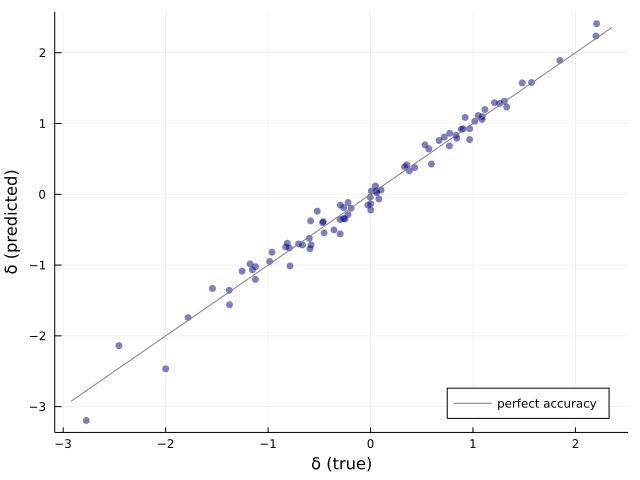

In [8]:
pl = plot(size=(640, 480), legend=:bottomright)

scatter!(pl, truedelta, preddelta, label="", xlabel="δ (true)", ylabel="δ (predicted)", alpha=0.5, msw=0, mc=:navy)
plot!(pl, x->x, lc=:gray, label="perfect accuracy")

# savefig(pl, "plots/param-est-static-nonnested.pdf")

pl

As the plot above shows, this parameter estimation technique appears to be working well.

## Fitting a static, nested MNL choice model
One issue with the MNL choice model is that it assumes the "independence of irrelevant alternatives," best understood through the example of the so-called red bus/blue bus paradox. Suppose that a customer, presented with a red bus and a car, chooses each with equal probability. Now suppose that a blue bus is added to the assortment. According to the MNL model, the customer's likelihood of choosing the blue bus must be nonzero, while the relative preferability of the red bus and car cannot change, and thus, that the customer is less likely to choose the car. This violates our intuition, which says that the customer probably does not care about the color of the bus, and that instead the red bus and blue bus must "share" the probability originally allocated to the former.

An easy solution to this problem is known as the *nested* MNL choice model, which says the the customer first chooses a *nest* from among the $s$ nests or product categories (indexed by $k$) available. The choice of nest is itself made using an MNL model, and each nest's preferability parameter is written $\sigma_k$. Then, the customer chooses a product from within the nest. For convenience, we will assume each nest contains $n$ products. Now $\delta$ is an $s$-by-$n$ matrix, where $\delta_{ki}$ denotes the preferability associated with the $i$th product in nest $k$.

Extending the notation used above, let $j$'s choice of product be represented by the tuple $(x_j, y_j)$, whose entries denote the product $y_j$ chosen and the nest $x_j$ to which $y_j$ belongs. We will let $\delta_j = \delta_{y_j}$ denote the utility parameter with that product, and $\sigma_j = \sigma_{x_j}$ the parameter associated with the nest.

The assortment $\mathcal{A}_j$ presented to the $j$th customer may span the $s$ nests in any arbitrary way. Let $\mathcal{A}_j^{\text{nests}}$ denote the set of nests represented in the assortment $\mathcal{A}_j$, and let $\mathcal{A}_{j}^{\text{products}}$ denote the set of products that are in both the nest that contains $y_j$ and the assortment $\mathcal{A}_j$. 

The parameter estimation problem is still convex. The likelihood function is
$$\prod_{j=1}^m \frac{\exp \sigma_j}{\sum_{k\in \mathcal{A}_j^{\text{nests}}} \exp \sigma_k} \cdot \frac{\exp \delta_j}{\sum_{l\in\mathcal{A}_{j}^{\text{products}}} \exp \delta_l}$$
and we can estimate the parameters by maximizing 
$$f(\sigma, \delta) = \sum_{j=1}^m \left( \sigma_j + \delta_j - \log \sum_{k\in \mathcal{A}_j^{\text{nests}}} \exp \sigma_k - \log \sum_{l\in\mathcal{A}_{j}^{\text{products}}} \exp \delta_l\right)$$
 
This model requires somewhat greater care in the implementation. I first represent each assortment as a vector of tuples, then provide separate columns corresponding to $\mathcal{A}_j^{\text{nests}}$ and $\mathcal{A}_{j}^{\text{products}}$, with the understanding that the information provided by these columns is implied by the  assortment and the choice $(x_j, y_j)$. 

Without loss of generality, I center $\sigma$ and the rows of $\delta$ at zero.

In [9]:
function make_nmnl_survey_data(m = 50000,    # Number of survey respondents
                               s = 10,       # Number of nests
                               n = 12)       # Number of products within each nest
    # Ground truths
    truesigma = randn(s)
    truesigma .-= mean(truesigma)

    truedelta = randn(s, n)
    truedelta .-= mean(truedelta, dims=2)

    # Possible (x, y) pairs
    product_idxs = collect(product(1:s, 1:n))
    
    nmnl = DataFrame()

    # Random assortments of (x, y) pairs with disregard to nests
    nmnl[!, :assortment] = Vector{Tuple{Int64, Int64}}[sample(product_idxs, rand(2:5), replace=false) for j in 1:m]
    
    # Blank columns
    nmnl[!, :nestchoices] = fill(Int64[], m)
    nmnl[!, :nestpick] = zeros(Int64, m)
    nmnl[!, :prodchoices] = fill(Int64[], m)
    nmnl[!, :prodpick] = zeros(Int64, m)

    for (j, A) in enumerate(nmnl[!, :assortment])
        # Customers choose a nest first, then a product
        nmnl[j, :nestchoices] = collect(Set(k for (k, i) in A))
        nmnl[j, :nestpick] = nmnl[j, :nestchoices][argmax(truesigma[nmnl[j, :nestchoices]] + rand(Gumbel(), length(nmnl[j, :nestchoices])))]
        nmnl[j, :prodchoices] = map(b -> b[2], filter(a -> a[1] == nmnl[j, :nestpick], A))
        nmnl[j, :prodpick] = nmnl[j, :prodchoices][argmax(truedelta[nmnl[j, :nestpick], nmnl[j, :prodchoices]] + rand(Gumbel(), length(nmnl[j, :prodchoices])))]
    end
    
    return truesigma, truedelta, nmnl
end

m, s, n = 50000, 10, 12
truesigma, truedelta, nmnl = make_nmnl_survey_data()
nmnl[1:5, :]

,assortment,nestchoices,nestpick,prodchoices,prodpick
,Array…,Array…,Int64,Array…,Int64
1,"[(1, 9), (4, 1)]","[4, 1]",4,[1],1
2,"[(3, 7), (9, 5), (5, 8), (1, 2)]","[5, 9, 3, 1]",9,[5],5
3,"[(4, 4), (1, 5), (4, 7), (10, 6)]","[4, 10, 1]",10,[6],6
4,"[(6, 12), (4, 2), (4, 3)]","[4, 6]",4,"[2, 3]",2
5,"[(2, 3), (8, 3), (6, 11), (3, 2), (6, 7)]","[6, 2, 8, 3]",6,"[11, 7]",11


In [10]:
# Log likelihood function derived above
function nmnl_loglikelihood(sigma,
                            delta;
                            nestchoices=nmnl[!, :nestchoices],
                            nestpicks=nmnl[!, :nestpick],
                            prodchoices=nmnl[!, :prodchoices],
                            prodpicks=nmnl[!, :prodpick])
    exp_sigma = exp.(sigma)
    exp_delta = exp.(delta)
    return -sum(sigma[nestpicks[j]] +
                delta[nestpicks[j], prodpicks[j]] -
                log(sum(exp_sigma[nestchoices[j]])) -
                log(sum(exp_delta[nestpicks[j], prodchoices[j]]))
                for j in 1:length(nestchoices))
end

# "Flattened" version that allows a long vector as input
# So we can interface with Optim.jl
function nmnl_loglikelihood_flat(sigma_delta)
    sigma, delta = sigma_delta[1:s], reshape(sigma_delta[s+1:end], s, n)
    return nmnl_loglikelihood(sigma, delta)
end

nmnl_loglikelihood_flat (generic function with 1 method)

The optimization takes much longer in this case (about 3.5 minutes), owing to the large number of decision variables. This can be improved by writing the analytic derivative instead of relying on autodiff. 

In [11]:
res = optimize(nmnl_loglikelihood_flat, zeros(s + s*n), LBFGS(m=20); autodiff=:forward)

predsigma, preddelta = res.minimizer[1:s], reshape(res.minimizer[s+1:end], s, n)
predsigma .-= mean(predsigma)
preddelta .-= mean(preddelta, dims=2)

res

 * Status: success

 * Candidate solution
    Final objective value:     5.433526e+04

 * Found with
    Algorithm:     L-BFGS

 * Convergence measures
    |x - x'|               = 3.47e-11 ≰ 0.0e+00
    |x - x'|/|x'|          = 9.62e-12 ≰ 0.0e+00
    |f(x) - f(x')|         = 3.47e-09 ≰ 0.0e+00
    |f(x) - f(x')|/|f(x')| = 6.39e-14 ≰ 0.0e+00
    |g(x)|                 = 9.68e-09 ≤ 1.0e-08

 * Work counters
    Seconds run:   124  (vs limit Inf)
    Iterations:    116
    f(x) calls:    352
    ∇f(x) calls:   352


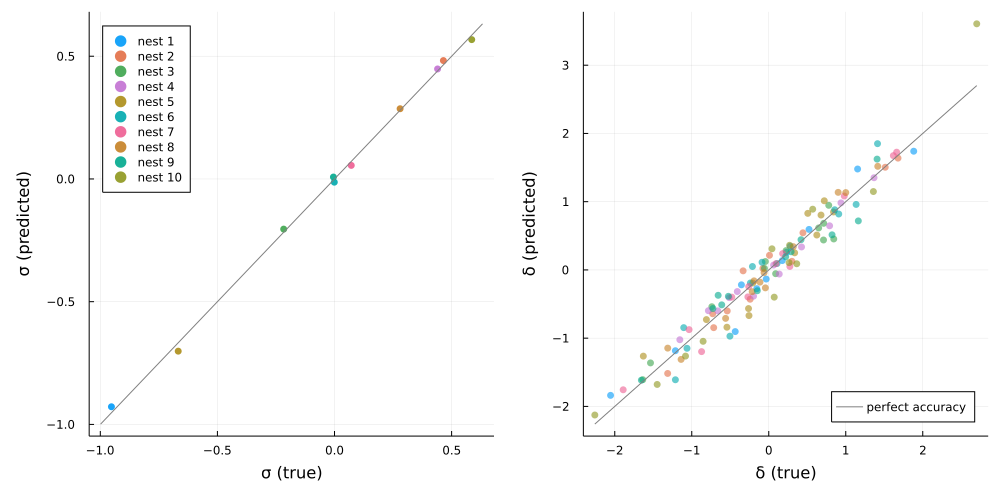

In [12]:
pl = plot(layout=2, size=(1000, 500), legend=[:topleft :bottomright], leftmargin=20pt, bottommargin=20pt) 

for k in 1:s
    scatter!(pl[1], [truesigma[k]], [predsigma[k]], xlabel="σ (true)", ylabel="σ (predicted)",
         msw=0, alpha=0.9, label="nest $k")
end
plot!(pl[1], x->x, lc=:gray, label="")

scatter!(pl[2], truedelta', preddelta', xlabel="δ (true)", ylabel="δ (predicted)", label="",
         msw=0, alpha=0.6)
mnm = [minimum(truedelta), maximum(truedelta)]
plot!(pl[2], mnm, mnm, lc=:gray, label="perfect accuracy")

# savefig(pl, "plots/param-est-static-nested.pdf")

pl

The plot suggests that we determined the parameters correctly.

## Hypothesis tests

We can do some simple hypothesis tests to determine if the parameters are significantly different from some baseline (e.g. $\delta = \vec 0$, the case in which all items are equally preferable), subject to the assumption that the underlying choice model is in fact MNL.

Specifically, let $\hat \delta$ denote the obtained parameter estimate, and $\delta_0$ denote the parameters associated with the null hypothesis. Then the likelihood ratio $2 f(\hat \delta) - 2 f(\delta_0)$ has a $\chi^2$ distribution with $n$ degrees of freedom. By homogeneity, this statistic tests the null hypothesis that the parameters are given by $\delta_0$ *or* some scalar translation thereof. 

The likelihood ratio method can be extended to the case where the null hypothesis is an arbitrary constraint on the parameters, as discussed by Croissant (n.d.). 

In [11]:
# Ignore the true delta
m, n = 3, 5
_, mnl = make_mnl_survey_data(m, n)

res = optimize(mnl_loglikelihood, zeros(n), LBFGS(m=20); autodiff=:forward)
preddelta = res.minimizer .- mean(res.minimizer)

# Negative because of how we constructed mnl_loglikelihood()
test_stat = -2 * (mnl_loglikelihood(preddelta) - mnl_loglikelihood(zeros(n)))

# Will probably be large (> 0.05), because sample size is tiny
p = ccdf(Chisq(n), test_stat)

0.3070503414156627

In [12]:
# Ignore the true delta
m, n = 100, 5
_, mnl = make_mnl_survey_data(m, n)

res = optimize(mnl_loglikelihood, zeros(n), LBFGS(m=20); autodiff=:forward)
preddelta = res.minimizer .- mean(res.minimizer)

# Negative because of how we constructed mnl_loglikelihood()
test_stat = -2 * (mnl_loglikelihood(preddelta) - mnl_loglikelihood(zeros(n)))

# Will probably be small, because sample size is large
p = ccdf(Chisq(n), test_stat)

3.90119992876739e-17

## Data stream model

Now suppose that we are working in a limited-memory context that doesn't allow us to store the full data frame of consumer choices. Instead, we observe consumer choices one at a time, and all we are allowed to keep track of is an estimate of $\delta$, $\sigma$, and a state variable $t$ representing the number of samples used to create the current estimate (in other words, our "confidence" in the current estimate). How should we update our parameter estimate in response to a new observation?

First, consider the nonnested MNL model. At time $t$, we have an estimate $\delta^{(t)}$ and we witness a customer choose $y_t$ from the assortment $\mathcal{A}_t$. Intuitively, we should increase the value of $\delta_t$ and decrease the value of the other products in the assortment. We have not received any information about the items not in $\mathcal{A}_t$, so we will leave their $\delta$-values unchanged.

I will represent the update using the vector $z^{(t)}$, whose indices correspond to the indices in the assortment $\mathcal{A}_t$. Specifically, let
$$z^{(t)} = e_{y_t} - \frac{1}{\sum_{i\in \mathcal{A}_t} \exp \delta_i}\delta^{(t)}_{\mathcal{A}_t} $$
where $e_{y_t}$ is the vector that has a one at the $y_t$th index and zeros elsewhere, and $\delta^{(t)}_{\mathcal{A}_t}$ denotes our current estimate of the parameters in $\mathcal{A}_t$.

Observe that the expected value of $e_{y_t}$ is the vector whose entries correspond to the probability of choosing each item in $\mathcal{A}_t$ given that assortment. That is, $$\mathbb{E}(e_{y_t}) = \frac{1}{\sum_{i\in \mathcal{A}_t} \exp \delta_i}\delta_{\mathcal{A}_t}$$
where I have omitted the superscript on $\delta$ to represent the true, unknown parameter that we are trying to estimate.

Thus, the expected value of $z^{(t)}$ is zero when $\delta^{(t)} = \delta$. 

This means that $z^{(t)}$ is a kind of gradient for the likelihood function. Specifically, if $v$ is the vector points from $\delta^{(t)}$ to $\delta$, then $z$ is an estimate of the *projection* of this vector onto the $|\mathcal{A}_t|$ variables represented in the subset.

Because $z^{(t)}$ is (in expectation) an improvement direction for the parameter estimate, we can use it as a step direction in a Robbins-Munro algorithm, analogous to stochastic gradient descent. Stochastic convergence is guaranteed when using the following $\delta$ update with step-size parameters $\alpha >0$ and $t\in (0, 1]$:
$$\delta^{(t+1)}_{\mathcal{A}_t} = \delta^{(t)}_{\mathcal{A}_t} + \frac{\alpha}{t^r} z^{(t)}$$
The other $\delta$-values are not changed. 

Observe that this update does not change the sum of $\delta$-values, because the sum of the entries of $z$ is always zero. 

A very similar formulation can be derived in the nested case.

In [19]:
m = 50000
n = 7

truedelta, mnl = make_mnl_survey_data(m, n)

# Does the update above and stores the iterates in a matrix
function streamupdate(T=m; delta0=randn(n), α=0.01, r=0.05)
    res_delta = zeros(Float64, n, T+1)
    res_delta[:, 1] = delta0
    
    for t in 1:T
        # Stream in the latest observation
        A = mnl[t, :assortment]
        
        # Predicted choice probabilities
        pred = exp.(delta0[A])
        pred ./= sum(pred)
        
        # Actual choice, so z = e_pick - pred
        pick = mnl[t, :pick]
        
        # Step size
        step = α / t^r
    
        # Equiv to delta0[A] += step * z
        delta0[A] -= step * pred
        delta0[pick] += step
        
        # Center the params again. Not mathematically necessary 
        # but avoids runaway floating-point errors
        delta0 .-= mean(delta0)
        
        res_delta[:, t+1] = delta0
    end
    
    return res_delta
end

# Number of iterations to plot
T = 25000

@time res_delta = streamupdate(T)
res_delta_ra = rollingaverage(res_delta, T÷50);

  0.249210 seconds (574.24 k allocations: 25.875 MiB, 48.88% compilation time)


In [20]:
mnm = 1.5 .* (minimum(truedelta), maximum(truedelta))

function so_far(t)
    pl = plot(size=(1000, 500), legend=false, xlim=(0, T), leftmargin=15pt, bottommargin=10pt, rightmargin=20pt, ylim=mnm)

    colors = color_list(:auto)

    for i in 1:n
        plot!(pl, 0:t, res_delta[i, 1:t+1], c=colors[i], label="", ylabel="δ", xlabel="t", alpha=0.3)
        hline!(pl, [truedelta[i]], c=colors[i], ls=:dash, lw=0.75)
        plot!(pl, 0:t, res_delta_ra[i, 1:t+1], c=colors[i], label="", ylabel="δ", xlabel="t", lw=1.5)
    end

    return pl
end

pl = so_far(T)

# savefig(pl, "plots/param-est-dynamic-nonnested.pdf")
# savefig(pl, "plots/param-est-dynamic-nonnested.png")

pl

In [15]:
anim = @animate for t in 1:T÷100:T
    so_far(t)
end

# gif(anim, "param-est-dynamic-nonnested.gif", fps=20)

Animation("C:\\Users\\Max\\AppData\\Local\\Temp\\jl_hEJaw8", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000091.png", "000092.png", "000093.png", "000094.png", "000095.png", "000096.png", "000097.png", "000098.png", "000099.png", "000100.png"])

The plots above indicate the stochastic converge of the algorithm. Tweaking the step size parameters can yield a less bumpy ride at the cost of slower convergence.

## Dynamic estimation of nested MNL model

I extend the model above to the MNL model with multiple nests.

In [13]:
m = 60000
s = 4
n = 3

truesigma, truedelta, nmnl = make_nmnl_survey_data(m, s, n)

function streamupdate(T=m; sigma0=randn(s), delta0=randn(s, n), α=0.01, r=0.05)
    res_sigma = zeros(Float64, s, T+1)
    res_delta = zeros(Float64, s, n, T+1)
    
    res_sigma[:, 1] = sigma0
    res_delta[:, :, 1] = delta0
    
    for t in 1:T        
        step = α / t^r
        
        nestchoices = nmnl[t, :nestchoices]
        prodchoices = nmnl[t, :prodchoices] 
        
        nestpick = nmnl[t, :nestpick]
        prodpick = nmnl[t, :prodpick]
            
        nestpred = exp.(sigma0[nestchoices])
        nestpred ./= sum(nestpred)
        
        prodpred = exp.(delta0[nestpick, prodchoices])
        prodpred ./= sum(prodpred)
        
        sigma0[nestchoices] -= step * nestpred
        sigma0[nestpick] += step
            
        delta0[nestpick, prodchoices] -= step * prodpred * n
        delta0[nestpick, prodpick] += step * n
        
        sigma0 .-= mean(sigma0)
        delta0 .-= mean(delta0, dims=2)
        
        res_sigma[:, t+1] = sigma0
        res_delta[:, :, t+1] = delta0
    end
    
    return res_sigma, res_delta
end

T = 60000
@time res_sigma, res_delta = streamupdate(T);
res_sigma_ra = rollingaverage(res_sigma, T÷25);

res_delta_ra = similar(res_delta)
for k in 1:s
    res_delta_ra[k, :, :] = rollingaverage(res_delta[k, :, :], T÷50)
end

  0.913053 seconds (4.13 M allocations: 203.546 MiB, 13.23% gc time, 53.14% compilation time)


In [27]:
mnm_sigma = 1.5 .* (minimum(truesigma), maximum(truesigma))
mnm_delta = 1.2 .* (minimum(truedelta), maximum(truedelta))

function so_far(t)
    pl = plot(layout=grid(2, 1, heights=[0.4, 0.6]), size=(1000, 700), legend=false, xlim=(0, T), leftmargin=15pt, bottommargin=10pt, rightmargin=20pt)

    colors = color_list(:auto)
    
    for k in 1:s
        plot!(pl[1], 0:t, res_sigma[k, 1:t+1], c=colors[k], label="", ylabel="σ", alpha=0.3, ylim=mnm_sigma)
        hline!(pl[1], [truesigma[k]], c=colors[k], ls=:dash, lw=0.75)
        plot!(pl[1], 0:t, res_sigma_ra[k, 1:t+1], c=colors[k], label="", lw=1.5)
        
        for i in 1:n
            plot!(pl[2], 0:t, res_delta[k, i, 1:t+1], c=colors[k], label="", ylabel="δ", xlabel="t", alpha=0.3, ylim=mnm_delta)
            hline!(pl[2], [truedelta[k, i]], c=colors[k], ls=:dash, lw=0.75)
            plot!(pl[2], 0:t, res_delta_ra[k, i, 1:t+1], c=colors[k], label="", xlabel="t", lw=1.5)
        end
    end

    return pl
end

pl = so_far(T)

# savefig(pl, "plots/param-est-dynamic-nested.pdf")
# savefig(pl, "plots/param-est-dynamic-nested.png")

pl

## Using the dynamic model to estimate parameters in the static case

Iterating the dynamic model is actually much cheaper than performing the max likelihood optimization. Therefore, another option for estimating parameters in the static setting is to treat the sample as a data stream and take the average of the final 1000 iterations or so. I demonstrate this approach below. Notice that the convergence is weakest for the parameters with extreme values.

In [18]:
m = 500000
s = 10
n = 12

truesigma, truedelta, nmnl = make_nmnl_survey_data(m, s, n)
res_sigma, res_delta = streamupdate(m);

est_window = 0
sigma_est_stream = mean(res_sigma[:, end-est_window:end], dims=2)
delta_est_stream = reshape(mean(res_delta[:, :, end-est_window:end], dims=3), s, n);

In [15]:
res = optimize(nmnl_loglikelihood_flat, zeros(s + s*n), LBFGS(m=20); autodiff=:forward)

sigma_est_maxlik, delta_est_maxlik = res.minimizer[1:s], reshape(res.minimizer[s+1:end], s, n)
sigma_est_maxlik .-= mean(sigma_est_maxlik)
delta_est_maxlik .-= mean(delta_est_maxlik, dims=2)

res

 * Status: success

 * Candidate solution
    Final objective value:     4.753425e+05

 * Found with
    Algorithm:     L-BFGS

 * Convergence measures
    |x - x'|               = 2.78e-11 ≰ 0.0e+00
    |x - x'|/|x'|          = 7.67e-12 ≰ 0.0e+00
    |f(x) - f(x')|         = 4.97e-08 ≰ 0.0e+00
    |f(x) - f(x')|/|f(x')| = 1.04e-13 ≰ 0.0e+00
    |g(x)|                 = 7.33e-09 ≤ 1.0e-08

 * Work counters
    Seconds run:   1863  (vs limit Inf)
    Iterations:    159
    f(x) calls:    484
    ∇f(x) calls:   484


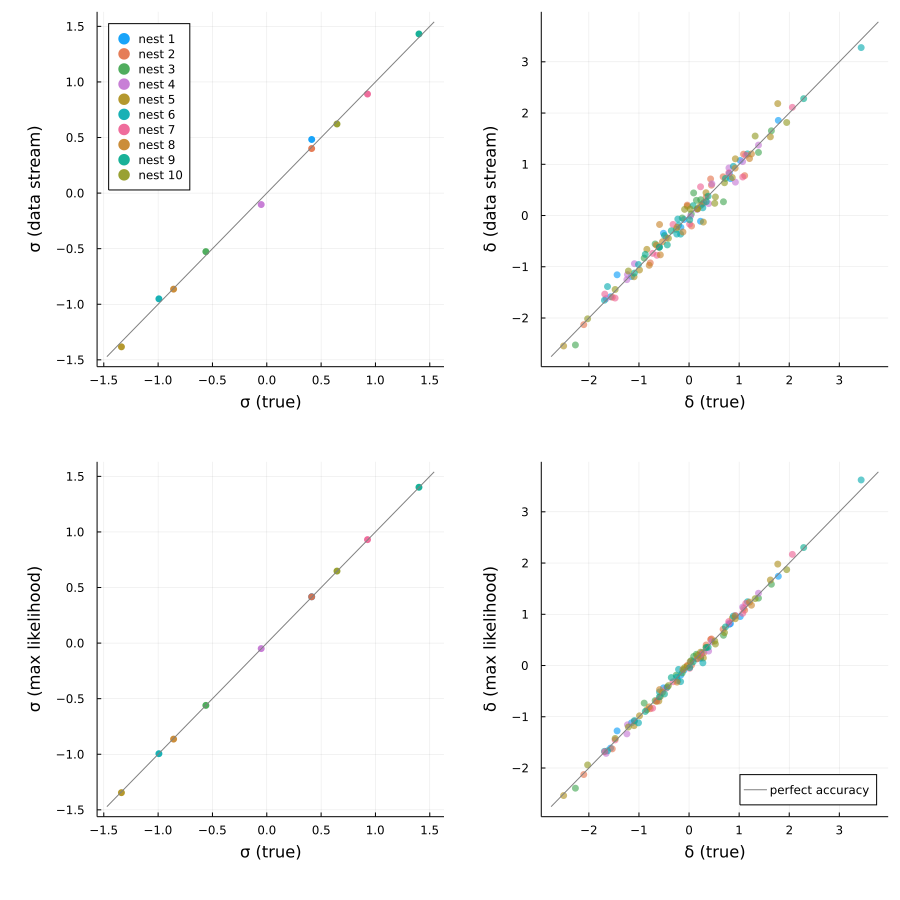

In [27]:
pl = plot(layout=(2, 2), size=(900, 900), legend=[:topleft :bottomright], leftmargin=20pt, bottommargin=20pt) 

for k in 1:s
    scatter!(pl[1, 1], [truesigma[k]], [sigma_est_stream[k]], xlabel="σ (true)", ylabel="σ (data stream)",
         msw=0, alpha=0.9, label="nest $k")
    scatter!(pl[2, 1], [truesigma[k]], [sigma_est_maxlik[k]], xlabel="σ (true)", ylabel="σ (max likelihood)",
         msw=0, alpha=0.9, label="")
end
mnm = 1.1 * [extrema(truesigma)...]
plot!(pl[1, 1], mnm, mnm, lc=:gray, label="")
plot!(pl[2, 1], mnm, mnm, lc=:gray, label="")

scatter!(pl[1, 2], truedelta', delta_est_stream', xlabel="δ (true)", ylabel="δ (data stream)", label="",
         msw=0, alpha=0.6)
scatter!(pl[2, 2], truedelta', delta_est_maxlik', xlabel="δ (true)", ylabel="δ (max likelihood)", label="",
         msw=0, alpha=0.6)
mnm = 1.1 * [extrema(truedelta)...]
plot!(pl[1, 2], mnm, mnm, lc=:gray, label="")
plot!(pl[2, 2], mnm, mnm, lc=:gray, label="perfect accuracy")

# savefig(pl, "plots/param-est-dynamic-nested-as-static.pdf")
# savefig(pl, "plots/param-est-dynamic-nested-as-static.png")

pl

## References
Croissant, Yves. "Estimation of multinomial logit models in R: The `mlogit` Packages." https://www-eio.upc.es/teaching/madt/apunts/mlogit_teoria.pdf. 

Wikipedia. "Discrete choice." https://en.wikipedia.org/wiki/Discrete_choice.

Wikipedia. "Likelihood-ratio test." https://en.wikipedia.org/wiki/Likelihood-ratio_test.

Wikipedia. "Stochastic approximation." https://en.wikipedia.org/wiki/Stochastic_approximation.
